# 音訊前置處理

## 載入相關套件

In [20]:
# 載入相關套件
import IPython
import pyaudio
import struct
import matplotlib.pyplot as plt
import numpy as np
from scipy import signal
import librosa
import librosa.display # 一定要加
from IPython.display import Audio

## 載入檔案

In [21]:
wav_file = './audio/WAV_1MG.wav'

data, sr = librosa.load(wav_file) 
print(f'取樣頻率={sr}, 總樣本數={data.shape}')

取樣頻率=22050, 總樣本數=(739329,)


In [22]:
data.shape[0] / sr

33.529659863945575

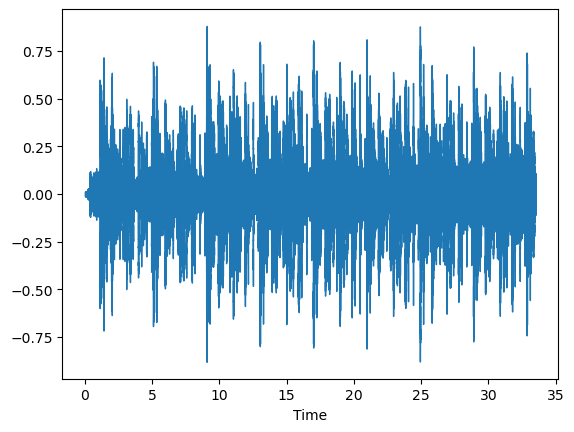

In [23]:
# 繪製波形
librosa.display.waveshow(data)

In [24]:
# 以 44.1K 取樣頻率載入檔案
data, sr = librosa.load(wav_file, sr=44100) 
print(f'取樣頻率={sr}, 總樣本數={data.shape}')

取樣頻率=44100, 總樣本數=(1478657,)


In [25]:
# 快速載入檔案
data, sr = librosa.load(wav_file, res_type='kaiser_fast') 
print(f'取樣頻率={sr}, 總樣本數={data.shape}')

取樣頻率=22050, 總樣本數=(739329,)


## 顯示頻譜圖

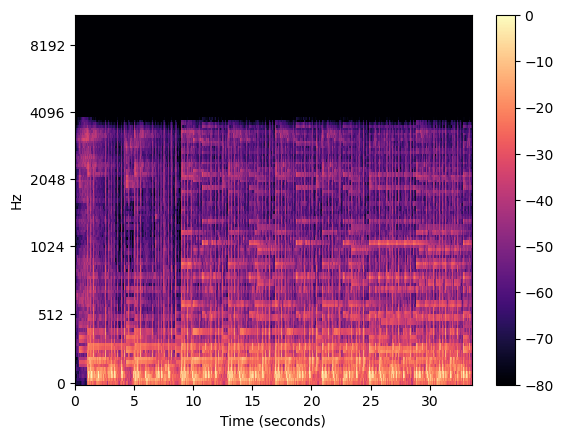

In [26]:
# 載入頻譜圖
spec = librosa.feature.melspectrogram(y=data, sr=sr)

# 顯示頻譜圖
db_spec = librosa.power_to_db(spec, ref=np.max,)
librosa.display.specshow(db_spec,y_axis='mel', x_axis='s', sr=sr)
plt.colorbar()

## 存檔

In [27]:
# 存檔
sr = 22050 # sample rate
T = 5.0    # seconds
t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.5*np.sin(2*np.pi*220*t)# pure sine wave at 220 Hz

#playing generated audio
Audio(x, rate=sr) # load a NumPy array

# v0.8後已不支援
# librosa.output.write_wav('generated.wav', x, sr) # writing wave file in .wav format
import soundfile as sf
sf.write('./audio/generated.wav', x, sr, 'PCM_24')


## 特徵萃取

In [28]:
# Short-time Fourier transform
# return complex matrix D[f, t], which f is frequency, t is time (frame).
D = librosa.stft(data)
print(D.shape, D.dtype)

(1025, 1445) complex64


In [29]:
# mfcc
mfcc = librosa.feature.mfcc(y=data, sr=sr, n_mfcc=40)
mfcc.shape

(40, 1445)

In [37]:
# Log-Mel Spectrogram
melspec = librosa.feature.melspectrogram(y = data, sr = sr, n_fft=1024, 
                                         hop_length=512, n_mels=128)
logmelspec = librosa.power_to_db(melspec)
logmelspec.shape

(128, 1445)

## Librosa 內建音訊

In [38]:
# librosa 內建音訊列表
librosa.util.list_examples()

AVAILABLE EXAMPLES
--------------------------------------------------------------------
brahms    	Brahms - Hungarian Dance #5
choice    	Admiral Bob - Choice (drum+bass)
fishin    	Karissa Hobbs - Let's Go Fishin'
humpback  	Glacier Bay 60-second clip humpback whale song November 2020
libri1    	Ashiel Mystery - A Detective Story, chapter 2, narrated by Garth Comira
libri2    	The Age of Chivalry / Chapter 18: Perceval / Read by Anders Lankford
libri3    	Sense and Sensibility / Chapter 18 / Jane Austen / Read by Heather Barnett
nutcracker	Tchaikovsky - Dance of the Sugar Plum Fairy
pistachio 	The Piano Lady - Pistachio Ice Cream Ragtime
robin     	Bird Whistling, Robin, Single, 13.wav / InspectorJ
sweetwaltz	Setuniman - Sweet Waltz
trumpet   	Mihai Sorohan - Trumpet loop
vibeace   	Kevin MacLeod - Vibe Ace


In [44]:
# 載入 librosa 內建音訊
y, sr = librosa.load(librosa.util.example('vibeace'))
print(f'取樣頻率={sr}, 總樣本數={y.shape}')

取樣頻率=22050, 總樣本數=(1355168,)


In [45]:
# 播放
Audio(y, rate=sr, autoplay=True)

In [46]:
# 另一內建音訊 nutcracker
filename = librosa.example('nutcracker')
y, sr = librosa.load(filename)
print(f'取樣頻率={sr}, 總樣本數={y.shape}')

取樣頻率=22050, 總樣本數=(2643264,)


In [47]:
Audio(y, rate=sr, autoplay=True)

In [49]:
# hq=True：high-quality mode
# 布拉姆斯 匈牙利舞曲
y, sr = librosa.load(librosa.example('brahms', hq=True))
print(f'取樣頻率={sr}, 總樣本數={y.shape}')
Audio(y, rate=sr, autoplay=True)

取樣頻率=22050, 總樣本數=(1010880,)


In [50]:
# hq=True：high-quality mode
y, sr = librosa.load(librosa.example('vibeace', hq=True))
print(len(y), sr)

1355168 22050


In [51]:
Audio(y, rate=sr, autoplay=True)

In [56]:
?librosa.resample

## 音訊處理與轉換

In [57]:
# 重取樣
sr_new = 11000
y = librosa.resample(y = y, orig_sr = sr, target_sr = sr_new)

print(len(y), sr_new)

Audio(y, rate=sr_new, autoplay=True)

676048 11000


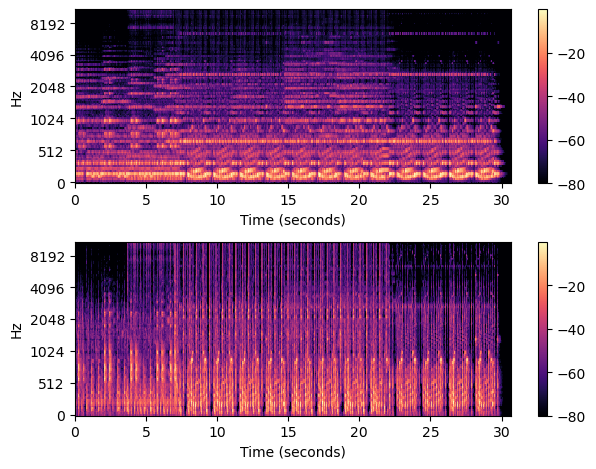

In [59]:
# 和音與敲擊音分離(Harmonic/Percussive Separation)
y_h, y_p = librosa.effects.hpss(y)
spec_h = librosa.feature.melspectrogram(y = y_h, sr=sr)
spec_p = librosa.feature.melspectrogram(y = y_p, sr=sr)
db_spec_h = librosa.power_to_db(spec_h,ref=np.max)
db_spec_p = librosa.power_to_db(spec_p,ref=np.max)

plt.subplot(2,1,1)
librosa.display.specshow(db_spec_h, y_axis='mel', x_axis='s', sr=sr)
plt.colorbar()

plt.subplot(2,1,2)
librosa.display.specshow(db_spec_p, y_axis='mel', x_axis='s', sr=sr)
plt.colorbar()

plt.tight_layout()

In [38]:
y_h.shape, y_p.shape

((1010880,), (1010880,))

In [17]:
# 敲擊音每分鐘出現的樣本數
print(librosa.beat.tempo(y, sr=sr))

[117.45383523]


In [18]:
# 播放和音(harmonic component)
IPython.display.Audio(data=y_h, rate=sr)

In [25]:
# 播放敲擊音(Percussive component)
IPython.display.Audio(data=y_p, rate=sr)

## 繪製色度圖(Chromagram)，chroma為半音(semitones)

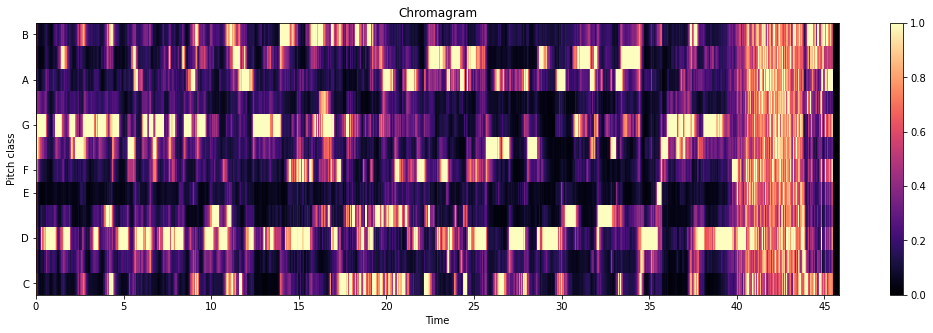

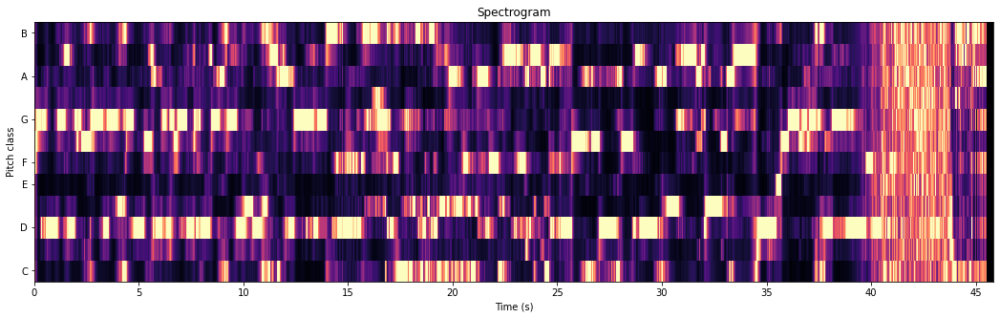

In [24]:
# 萃取音準(pitch)資訊
chroma = librosa.feature.chroma_cqt(y=y_h, sr=sr)
plt.figure(figsize=(18,5))
librosa.display.specshow(chroma, sr=sr, x_axis='time', y_axis='chroma', vmin=0, vmax=1)
plt.title('Chromagram')
plt.colorbar()

plt.figure(figsize=(18,5))
plt.title('Spectrogram')
librosa.display.specshow(chroma, sr=sr, x_axis='s', y_axis='chroma', )

In [32]:
# 將頻譜分為 8 個成份(Component)
# Short-time Fourier transform
D = librosa.stft(y)

# Separate the magnitude and phase
S, phase = librosa.magphase(D)

# Decompose by nmf
components, activations = librosa.decompose.decompose(S, n_components=8, sort=True)

C:\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'linscaley' parameter of __init__() has been renamed 'linscale' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


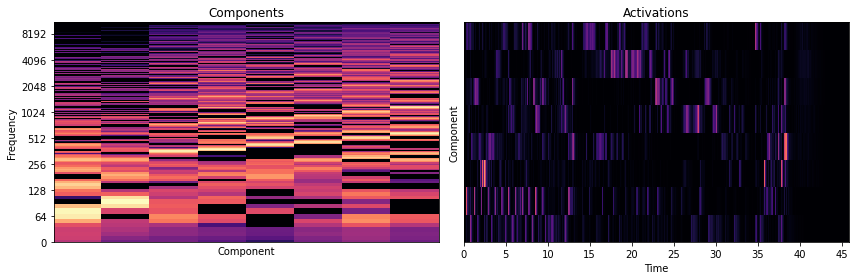

In [33]:
# 顯示成份(Component)與 Activations
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(components)
                         , ref=np.max), y_axis='log')
plt.xlabel('Component')
plt.ylabel('Frequency')
plt.title('Components')

plt.subplot(1,2,2)
librosa.display.specshow(activations, x_axis='time')
plt.xlabel('Time')
plt.ylabel('Component')
plt.title('Activations')

plt.tight_layout()

In [34]:
# 以 Components 與 Activations 重建音訊
D_k = components.dot(activations)

# invert the stft after putting the phase back in
y_k = librosa.istft(D_k * phase)

# And playback
print('Full reconstruction')

IPython.display.Audio(data=y_k, rate=sr)

Full reconstruction


In [35]:
# 只以第一 Component 與 Activation 重建音訊
k = 0
D_k = np.multiply.outer(components[:, k], activations[k])

# invert the stft after putting the phase back in
y_k = librosa.istft(D_k * phase)

# And playback
print('Component #{}'.format(k))

IPython.display.Audio(data=y_k, rate=sr)

Component #0


## Pre-emphasis：強調高頻的部分

C:\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'linscaley' parameter of __init__() has been renamed 'linscale' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


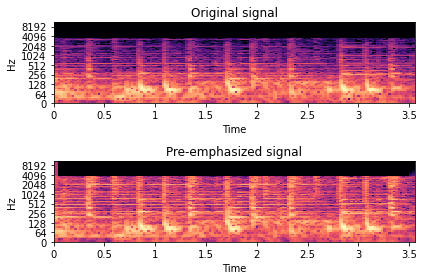

In [26]:
# Pre-emphasis：強調高頻的部分
import matplotlib.pyplot as plt

y, sr = librosa.load(wav_file, offset=30, duration=10)

y_filt = librosa.effects.preemphasis(y)

# 比較原音與修正的音訊
S_orig = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
S_preemph = librosa.amplitude_to_db(np.abs(librosa.stft(y_filt)), ref=np.max)

# 繪圖
plt.subplot(2,1,1)
librosa.display.specshow(S_orig, y_axis='log', x_axis='time')
plt.title('Original signal')

plt.subplot(2,1,2)
librosa.display.specshow(S_preemph, y_axis='log', x_axis='time')
fig=plt.title('Pre-emphasized signal')

plt.tight_layout()

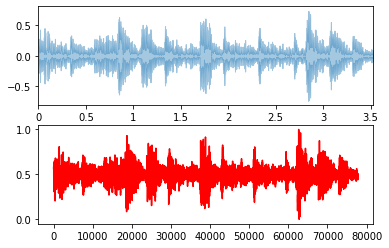

In [27]:
# 常態化
from sklearn.preprocessing import minmax_scale

wav_file = './audio/WAV_1MG.wav'
data, sr = librosa.load(wav_file, offset=30, duration=10)

plt.subplot(2,1,1)
librosa.display.waveplot(data, sr=sr, alpha=0.4)

plt.subplot(2,1,2)
fig = plt.plot(minmax_scale(data), color='r')